# Used Car price predition

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import seaborn as sns

%matplotlib inline

In [2]:
# Dataset is public in s3, i got dataset from kaggle
# df = pd.read_csv('dataset.csv')
df = pd.read_csv('https://bucketaiml.s3.amazonaws.com/dataset.csv')
# test_df = pd.read_csv('test-data.csv')

## Data Cleaning

In [3]:
df = df.iloc[:,1:]
df.head()

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Price
0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.6 km/kg,998 CC,58.16 bhp,5.0,NaN,1.75
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67 kmpl,1582 CC,126.2 bhp,5.0,NaN,12.50
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.2 kmpl,1199 CC,88.7 bhp,5.0,8.61 Lakh,4.50
3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.77 kmpl,1248 CC,88.76 bhp,7.0,NaN,6.00
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.2 kmpl,1968 CC,140.8 bhp,5.0,NaN,17.74


In [4]:
# df[df['Owner_Type']=='Second']

In [5]:
# Not considering Electric or CNG vehicles
df = df[(df['Fuel_Type']=='Diesel') | (df['Fuel_Type']=='Petrol') ]


In [6]:
# Cleaning some columns
df['Power'] = df['Power'].str.strip('bhp')
df['Mileage'] = df['Mileage'].str.strip('kmpl')
df['Engine']=df['Engine'].str.strip('CC')

In [7]:
df.columns

Index(['Name', 'Location', 'Year', 'Kilometers_Driven', 'Fuel_Type',
       'Transmission', 'Owner_Type', 'Mileage', 'Engine', 'Power', 'Seats',
       'New_Price', 'Price'],
      dtype='object')

In [8]:
# Need to change some datatypes
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5951 entries, 1 to 6018
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Name               5951 non-null   object 
 1   Location           5951 non-null   object 
 2   Year               5951 non-null   int64  
 3   Kilometers_Driven  5951 non-null   int64  
 4   Fuel_Type          5951 non-null   object 
 5   Transmission       5951 non-null   object 
 6   Owner_Type         5951 non-null   object 
 7   Mileage            5951 non-null   object 
 8   Engine             5915 non-null   object 
 9   Power              5915 non-null   object 
 10  Seats              5909 non-null   float64
 11  New_Price          814 non-null    object 
 12  Price              5951 non-null   float64
dtypes: float64(2), int64(2), object(9)
memory usage: 650.9+ KB


In [9]:
# Need to remove some nan value
df.isna().sum()

Name                    0
Location                0
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 0
Engine                 36
Power                  36
Seats                  42
New_Price            5137
Price                   0
dtype: int64

In [10]:
# Dealing with nan values

df['Seats'] = df['Seats'].fillna(5)
# df['Mileage'] = df['Mileage'].fillna(df['Mileage'].astype('float32').mean())

# df['Mileage'] = df['Mileage'].str.replace('null',np.nan)
# df['Engine'] = df['Engine'].str.replace('null',np.nan)
df['Power'] = df['Power'].str.strip().replace('null',np.nan)

df = df.dropna(subset= ['Engine', 'Power','Price'])
df['Mileage'] = df['Mileage'].astype('float16')
df['Engine'] = df['Engine'].astype('int16')

df['Power'].astype('float16')
;


''

In [11]:
df.head()

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Price
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.671875,1582,126.2,5.0,NaN,12.50
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.203125,1199,88.7,5.0,8.61 Lakh,4.50
3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.765625,1248,88.76,7.0,NaN,6.00
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.203125,1968,140.8,5.0,NaN,17.74
6,Nissan Micra Diesel XV,Jaipur,2013,86999,Diesel,Manual,First,23.078125,1461,63.1,5.0,NaN,3.50


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5809 entries, 1 to 6018
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Name               5809 non-null   object 
 1   Location           5809 non-null   object 
 2   Year               5809 non-null   int64  
 3   Kilometers_Driven  5809 non-null   int64  
 4   Fuel_Type          5809 non-null   object 
 5   Transmission       5809 non-null   object 
 6   Owner_Type         5809 non-null   object 
 7   Mileage            5809 non-null   float16
 8   Engine             5809 non-null   int16  
 9   Power              5809 non-null   object 
 10  Seats              5809 non-null   float64
 11  New_Price          814 non-null    object 
 12  Price              5809 non-null   float64
dtypes: float16(1), float64(2), int16(1), int64(2), object(7)
memory usage: 567.3+ KB


## Data Preprocessing and Visualization

In [13]:
df['Manufacturer'] = df['Name'].str.split(' ', expand=True)[0]

In [14]:
# Age of car
df['Age'] = 2020 - df['Year']

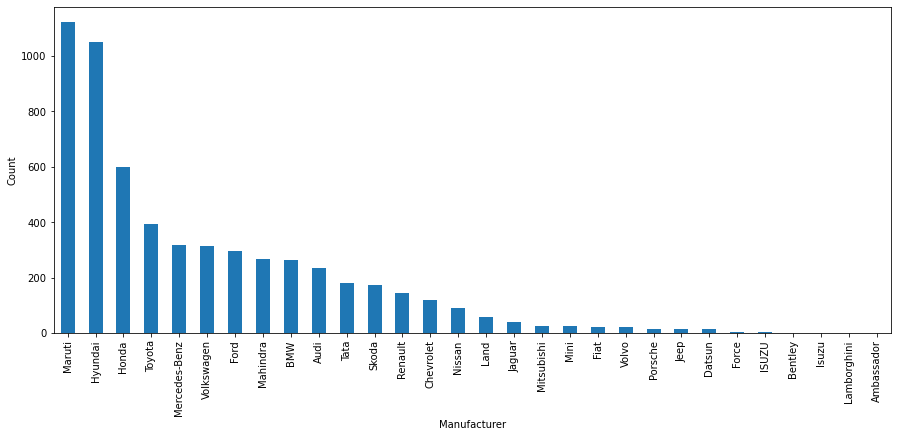

In [15]:
plt.figure(figsize=(15,6))
df.groupby('Manufacturer').count()['Name'].sort_values(ascending=False).plot.bar()
plt.ylabel('Count')
plt.show()

Text(0, 0.5, 'Price in INR Lakhs')

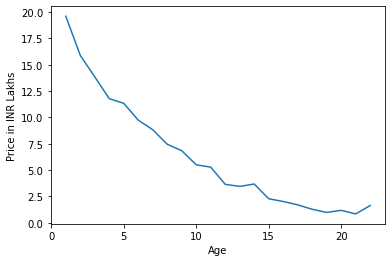

In [16]:
# Price of cars as year progresses
df.groupby('Age').mean()['Price'].plot()
plt.ylabel('Price in INR Lakhs')

In [17]:
# # Price of cars as number of kilometer driven increases
# kilometer_price = df.groupby('Kilometers_Driven').mean()['Price']
# plt.ylabel('Price in INR Lakhs')

In [51]:
# plt.scatter(x=kilometer_price.index, y=kilometer_price)

In [18]:
df.describe()

,Year,Kilometers_Driven,Mileage,Engine,Seats,Price,Age
count,5809.000000,5.809000e+03,5809.000000,5809.000000,5809.000000,5809.000000,5809.000000
mean,2013.474608,5.835621e+04,inf,1631.792391,5.286452,9.671011,6.525392
std,3.172185,9.264056e+04,4.296875,601.724341,0.806668,11.290834,3.172185
min,1998.000000,1.710000e+02,0.000000,624.000000,2.000000,0.440000,1.000000
25%,2012.000000,3.329200e+04,15.257812,1198.000000,5.000000,3.590000,4.000000
50%,2014.000000,5.243100e+04,18.203125,1497.000000,5.000000,5.750000,6.000000
75%,2016.000000,7.246500e+04,21.093750,1991.000000,5.000000,10.250000,8.000000
max,2019.000000,6.500000e+06,28.406250,5998.000000,10.000000,160.000000,22.000000


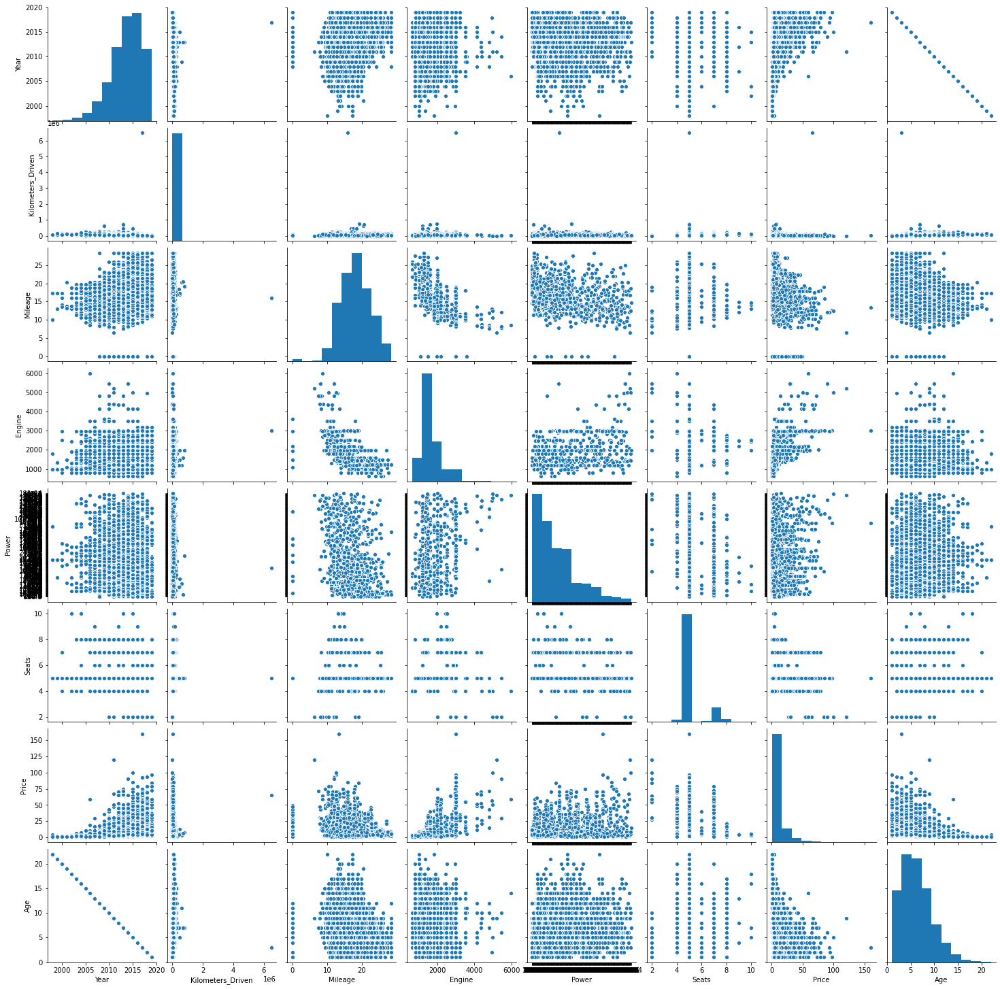

In [48]:
sns.pairplot(df)

In [19]:
# Creating Categorical columns

dataset = pd.get_dummies(df, columns=['Location','Fuel_Type','Transmission','Manufacturer','Owner_Type'], drop_first=True)

In [20]:
dataset = dataset.drop(columns=['Name', 'Year', 'New_Price'])
# train.drop(columns='New_Price', inplace=True)
dataset.columns.shape

(51,)

In [21]:
dataset.head()

,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Age,Location_Bangalore,Location_Chennai,Location_Coimbatore,...,Manufacturer_Porsche,Manufacturer_Renault,Manufacturer_Skoda,Manufacturer_Tata,Manufacturer_Toyota,Manufacturer_Volkswagen,Manufacturer_Volvo,Owner_Type_Fourth & Above,Owner_Type_Second,Owner_Type_Third
1,41000,19.671875,1582,126.2,5.0,12.50,5,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,46000,18.203125,1199,88.7,5.0,4.50,9,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,87000,20.765625,1248,88.76,7.0,6.00,8,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,40670,15.203125,1968,140.8,5.0,17.74,7,0,0,1,...,0,0,0,0,0,0,0,0,1,0
6,86999,23.078125,1461,63.1,5.0,3.50,7,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [22]:
X = dataset.drop(columns='Price')
y = dataset['Price']
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.33, random_state=42)

In [23]:
#Scaling
std_scaler = StandardScaler()
std_scaler.fit(X_train)
X_train = std_scaler.transform(X_train)
X_test = std_scaler.transform(X_test)

(3892, 50)

## Training

In [318]:
#Linear Regressor
linreg = LinearRegression()
linreg.fit(X_train, y_train)
y_pred = linreg.predict(X_test)
r2_score(y_test, y_pred)

0.7583660206578723

0.7583660206578723

In [291]:
'''
Random Forest
Try playing number n_estimators, max_depth until you get the right parameters
'''
randreg = RandomForestRegressor(n_estimators=100, max_depth=20)
randreg.fit(X_train, y_train)
y_pred = randreg.predict(X_test)
r2_score(y_test, y_pred)

0.8877111719400166

## We get better result using Random Forest rather than linear regressor

In [24]:
;

''